In [1]:
import os
import math
import shutil
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from skimage.metrics import mean_squared_error

plt.rcParams['figure.figsize'] = (12, 8)

In [10]:
MODIFIED_DATA = 'c:/Users/Groot/oral_cancer'

In [4]:
def get_dataset_size(path):
    num_of_images = {}
    for folder in os.listdir(path):
        folder_path = os.path.join(path, folder)

        num_images_in_folder = len(os.listdir(folder_path))

        num_of_images[folder] = num_images_in_folder

    return num_of_images

In [5]:
def find_del_dupl_img(file_name, file_dir):
    searched_img_path = os.path.join(file_dir, file_name)

    if not os.path.exists(searched_img_path):
        return

    searched_image = cv2.imread(searched_img_path, cv2.IMREAD_GRAYSCALE)

    duplicate_found = False
    
    for cmp_image_name in os.listdir(file_dir):
        cmp_image_path = os.path.join(file_dir, cmp_image_name)

        if cmp_image_name == file_name:
            continue

        if not os.path.isfile(cmp_image_path):
            continue

        try:
            cmp_image = cv2.imread(cmp_image_path, cv2.IMREAD_GRAYSCALE)
            rms = math.sqrt(mean_squared_error(searched_image, cmp_image))
        except Exception as e:
            continue

        if rms < 3:
            if not duplicate_found:
                fig = plt.figure(figsize=(6, 3))
                duplicate_found = True
            
            ax1 = fig.add_subplot(1, 2, 1)
            ax1.imshow(searched_image, cmap='gray')
            ax1.set_title("Searched Image")

            duplicate_image = cv2.imread(cmp_image_path, cv2.IMREAD_GRAYSCALE)
            ax2 = fig.add_subplot(1, 2, 2)
            ax2.imshow(duplicate_image, cmap='gray')
            ax2.set_title("Duplicate Image to be Removed")

            try:
                os.remove(cmp_image_path)
            except Exception as e:
                continue

    if duplicate_found:
        plt.tight_layout()
        plt.show()

In [12]:
def process_dataset(dataset_src, dataset_dest):

    shutil.copytree(dataset_src, dataset_dest)

    for folder in os.listdir(dataset_dest):
        for (index, file) in enumerate(os.listdir(os.path.join(dataset_dest, folder)), start=1):
            
            original_filename, ext = os.path.splitext(file)
            filename = f'{original_filename}_ckd{ext}'
            
            img_src = os.path.join(dataset_dest, folder, file)
            img_des = os.path.join(dataset_dest, folder, filename)

            img_org = cv2.imread(img_src)
            img = cv2.resize(img_org, (256, 256))
            img = cv2.copyMakeBorder(img, 2, 2, 2, 2, cv2.BORDER_CONSTANT, value=0)
            img = cv2.blur(img, (2, 2))
            cv2.imwrite(img_des, img_org)

            os.remove(img_src)

        for file in os.listdir(os.path.join(dataset_dest, folder)):
            find_del_dupl_img(file, os.path.join(dataset_dest, folder))

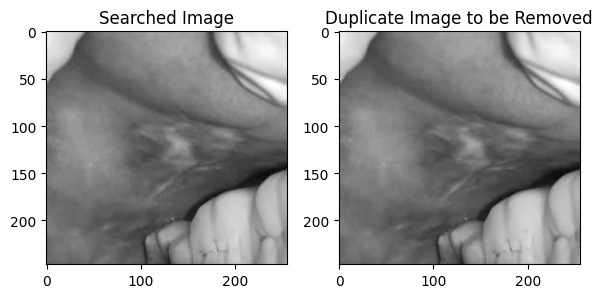

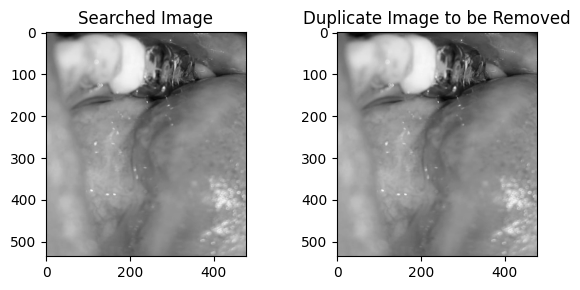

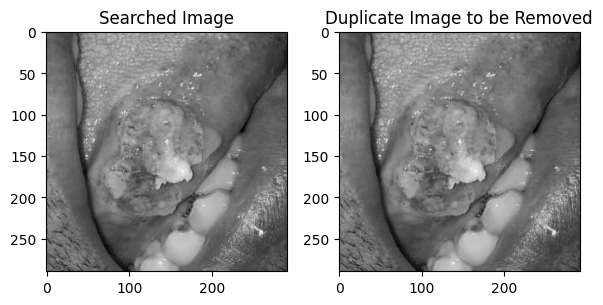

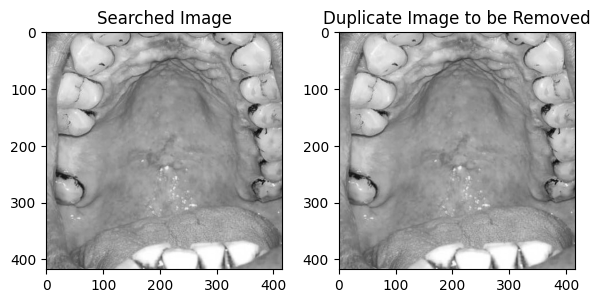

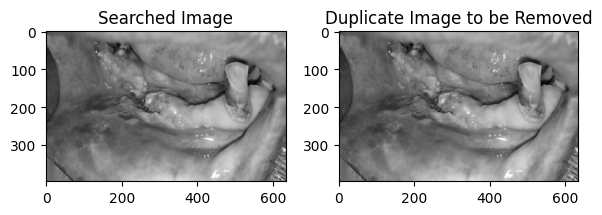

...

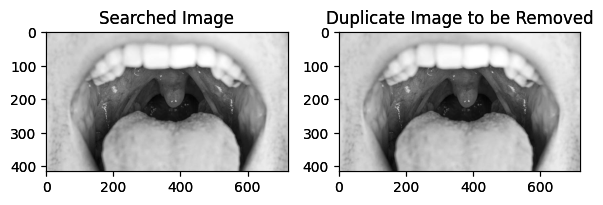

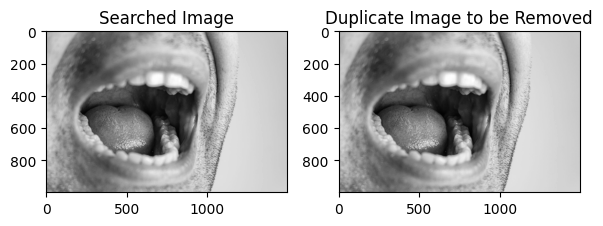

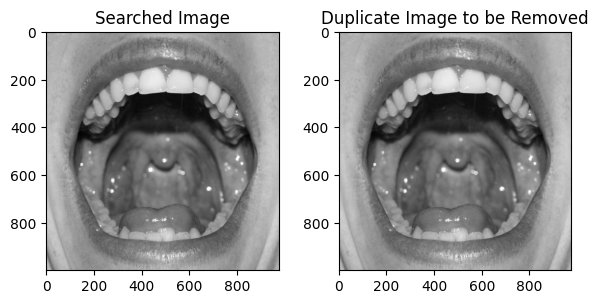

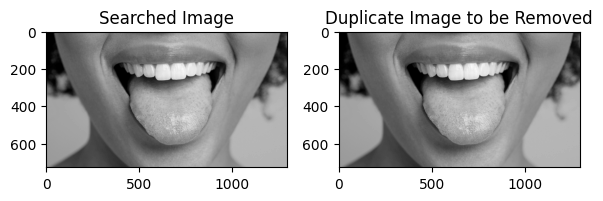

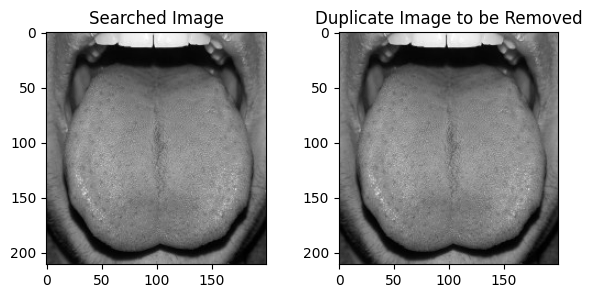

In [13]:
dataset_src = MODIFIED_DATA +'/complete_data'
dataset_dest = MODIFIED_DATA +'/rms_checked'

process_dataset(dataset_src, dataset_dest)

In [15]:
print('Dataset Size:', get_dataset_size(MODIFIED_DATA +'/complete_data'))
print('Dataset Size:', get_dataset_size(MODIFIED_DATA +'/rms_checked'))

Dataset Size: {'cancer': 745, 'non_cancer': 459}
Dataset Size: {'cancer': 491, 'non_cancer': 411}
